In [1]:
# ===========================================
# 1. Imports
# ===========================================
import os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

from itertools import cycle

from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_curve, auc
from sklearn.utils.class_weight import compute_class_weight
from sklearn.metrics import classification_report, confusion_matrix

# Evitar mensagens de log excessivas
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

2025-07-15 21:59:14.004039: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1752616754.212944      19 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1752616754.273457      19 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [2]:
# ===============================
# 2. Caminhos do Dataset
# ===============================
train_dir = '/kaggle/input/car-damage-severity-dataset/data3a/training'
val_dir = '/kaggle/input/car-damage-severity-dataset/data3a/validation'

# ===============================
# 3. Parâmetros
# ===============================
BATCH_SIZE = 32
IMG_SIZE = (224, 224)
EPOCHS = 100

In [3]:
# ===============================
# 4. Pré-processamento com Augmentation
# ===============================
train_datagen = ImageDataGenerator(rescale=1./255,
                                   rotation_range=40,
                                   width_shift_range=0.2,
                                   height_shift_range=0.2,
                                   zoom_range=0.3,
                                   shear_range=0.2,
                                   horizontal_flip=True,
                                   brightness_range=[0.8, 1.2])

val_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(train_dir,
                                                    target_size=IMG_SIZE,
                                                    batch_size=BATCH_SIZE,
                                                    class_mode='categorical',
                                                    shuffle=True)

val_generator = val_datagen.flow_from_directory(val_dir,
                                                target_size=IMG_SIZE,
                                                batch_size=BATCH_SIZE,
                                                class_mode='categorical',
                                                shuffle=False)

class_names = list(train_generator.class_indices.keys())
print("Classes:", class_names)

Found 1383 images belonging to 3 classes.
Found 248 images belonging to 3 classes.
Classes: ['01-minor', '02-moderate', '03-severe']


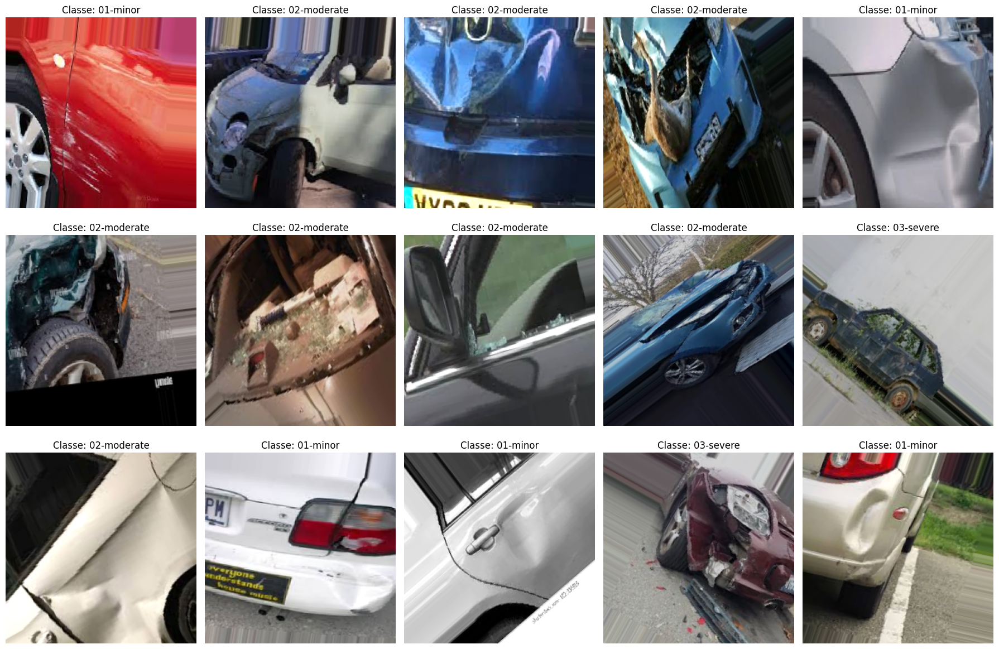

In [4]:
# ===========================================
# Visualização de imagens com Augmentation
# ===========================================
def show_augmented_images(generator, class_names, n_images=15):
    images, labels = next(generator)  # um batch aleatório
    plt.figure(figsize=(18, 12))
    for i in range(n_images):
        plt.subplot(3, 5, i + 1)
        plt.imshow(images[i])
        plt.axis('off')
        class_index = np.argmax(labels[i])
        plt.title(f"Classe: {class_names[class_index]}")
    plt.tight_layout()
    plt.show()

# Exibir imagens do gerador com augmentation
show_augmented_images(train_generator, class_names, n_images=15)


# Convolutional neural network 1

In [5]:
# ===========================================
# 5. Class Weights
# ===========================================
y_train = train_generator.classes
class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(y_train), y=y_train)
class_weights_dict = dict(enumerate(class_weights))


In [6]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dense, Dropout, Flatten, BatchNormalization

# ===========================================
# 6. CNN Customizada
# ===========================================
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    
    Conv2D(64, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),

    Conv2D(128, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    
    Conv2D(256, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),
    
    Flatten(),
    Dense(512, activation='relu'),
    Dropout(0.5),
    Dense(128, activation='relu'),
    Dropout(0.3),
    Dense(3, activation='softmax')
])

model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# ===========================================
# 7. Callbacks
# ===========================================
callbacks = [
    EarlyStopping(patience=5, restore_best_weights=True),
    ModelCheckpoint('cnn_custom_best.h5', save_best_only=True)
]

model.summary()


/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
I0000 00:00:1752616771.823851      19 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13942 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5
I0000 00:00:1752616771.824669      19 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 13942 MB memory:  -> device: 1, name: Tesla T4, pci bus id: 0000:00:05.0, compute capability: 7.5


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 222, 222, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 109, 109, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 52, 52, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 24, 24, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 24, 24, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 12, 12, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 36864)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 512)            │    18,874,880 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 128)            │        65,664 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 3)              │           387 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 19,331,267 (73.74 MB)

 Trainable params: 19,330,307 (73.74 MB)

 Non-trainable params: 960 (3.75 KB)

In [7]:
# Treinamento
history = model.fit(train_generator,
                    validation_data=val_generator,
                    epochs=EPOCHS)

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/100


I0000 00:00:1752616780.590935      78 service.cc:148] XLA service 0x7d2190015cf0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1752616780.591743      78 service.cc:156]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1752616780.591767      78 service.cc:156]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
I0000 00:00:1752616781.263478      78 cuda_dnn.cc:529] Loaded cuDNN version 90300


 2/44 ━━━━━━━━━━━━━━━━━━━━ 3s 82ms/step - accuracy: 0.3516 - loss: 2.2316  

I0000 00:00:1752616789.307772      78 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


44/44 ━━━━━━━━━━━━━━━━━━━━ 46s 722ms/step - accuracy: 0.3863 - loss: 2.5745 - val_accuracy: 0.3306 - val_loss: 2.9488
Epoch 2/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 21s 476ms/step - accuracy: 0.4284 - loss: 1.7578 - val_accuracy: 0.3306 - val_loss: 5.7353
Epoch 3/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 20s 460ms/step - accuracy: 0.4200 - loss: 1.4085 - val_accuracy: 0.3306 - val_loss: 5.9321
Epoch 4/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 21s 466ms/step - accuracy: 0.4505 - loss: 1.2697 - val_accuracy: 0.3306 - val_loss: 6.9170
Epoch 5/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 21s 471ms/step - accuracy: 0.4492 - loss: 1.1704 - val_accuracy: 0.3306 - val_loss: 6.6516
Epoch 6/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 20s 463ms/step - accuracy: 0.4157 - loss: 1.1871 - val_accuracy: 0.3306 - val_loss: 4.5094
Epoch 7/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 20s 461ms/step - accuracy: 0.4614 - loss: 1.0957 - val_accuracy: 0.3306 - val_loss: 3.4796
Epoch 8/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 20s 459ms/step - accuracy: 0.4907 - loss: 1.0380 - val_accuracy

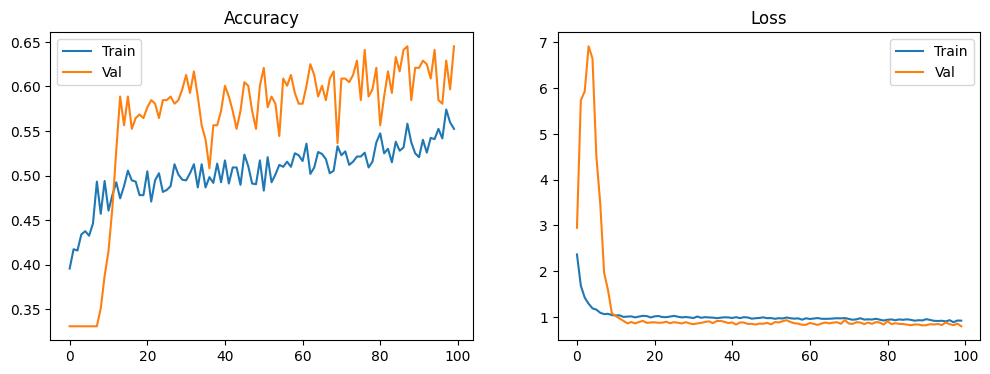

In [8]:
# 9. Avaliação
# ===========================================
def plot_history(history):
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Train')
    plt.plot(history.history['val_accuracy'], label='Val')
    plt.title("Accuracy")
    plt.legend()
    
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Train')
    plt.plot(history.history['val_loss'], label='Val')
    plt.title("Loss")
    plt.legend()
    plt.show()

plot_history(history)

In [9]:
# Previsões
val_generator.reset()
y_true = val_generator.classes
y_pred_probs = model.predict(val_generator)
y_pred_classes = np.argmax(y_pred_probs, axis=1)

8/8 ━━━━━━━━━━━━━━━━━━━━ 2s 143ms/step


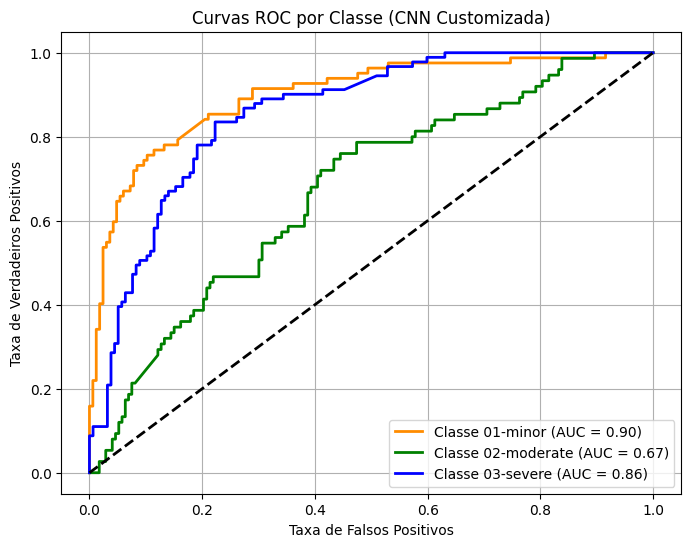

In [10]:
# Binarização dos rótulos verdadeiros
y_true_bin = label_binarize(y_true, classes=[0, 1, 2])  # 3 classes

# Curvas ROC
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(3):
    fpr[i], tpr[i], _ = roc_curve(y_true_bin[:, i], y_pred_probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Cores e plot
colors = cycle(['darkorange', 'green', 'blue'])
plt.figure(figsize=(8, 6))

for i, color in zip(range(3), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'Classe {class_names[i]} (AUC = {roc_auc[i]:.2f})')

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlabel('Taxa de Falsos Positivos')
plt.ylabel('Taxa de Verdadeiros Positivos')
plt.title('Curvas ROC por Classe (CNN Customizada)')
plt.legend(loc="lower right")
plt.grid()
plt.show()

In [11]:
print("Classification Report:")
print(classification_report(y_true, y_pred_classes, target_names=class_names))

Classification Report:
              precision    recall  f1-score   support

    01-minor       0.81      0.71      0.75        82
 02-moderate       0.46      0.29      0.36        75
   03-severe       0.62      0.88      0.73        91

    accuracy                           0.65       248
   macro avg       0.63      0.63      0.61       248
weighted avg       0.63      0.65      0.63       248



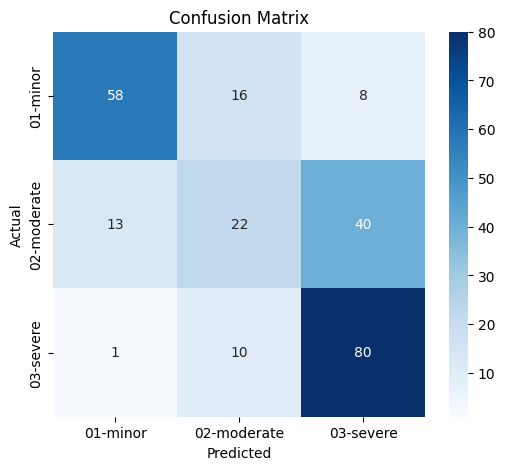

In [12]:
# Matriz de confusão
cm = confusion_matrix(y_true, y_pred_classes)
plt.figure(figsize=(6,5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

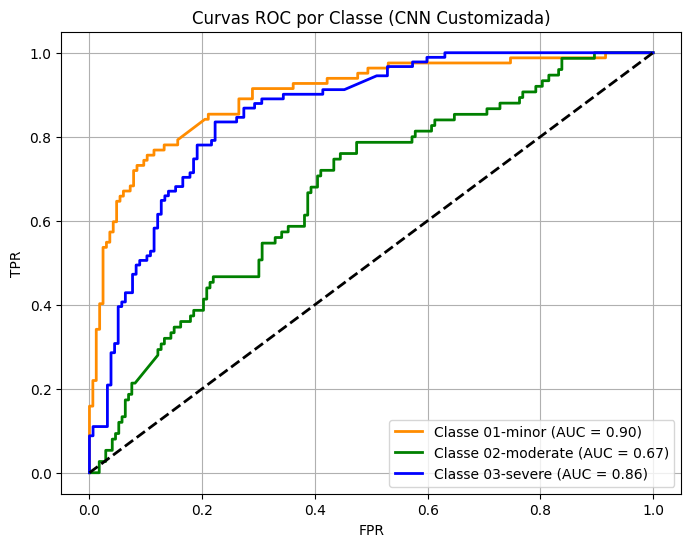

In [13]:
# ===========================================
# 10. Curva ROC
# ===========================================
y_true_bin = label_binarize(y_true, classes=[0, 1, 2])
fpr, tpr, roc_auc = {}, {}, {}
for i in range(3):
    fpr[i], tpr[i], _ = roc_curve(y_true_bin[:, i], y_pred_probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

colors = cycle(['darkorange', 'green', 'blue'])
plt.figure(figsize=(8, 6))
for i, color in zip(range(3), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'Classe {class_names[i]} (AUC = {roc_auc[i]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.title('Curvas ROC por Classe (CNN Customizada)')
plt.legend(loc="lower right")
plt.grid()
plt.show()


✅ Previsões Aleatórias da CNN:


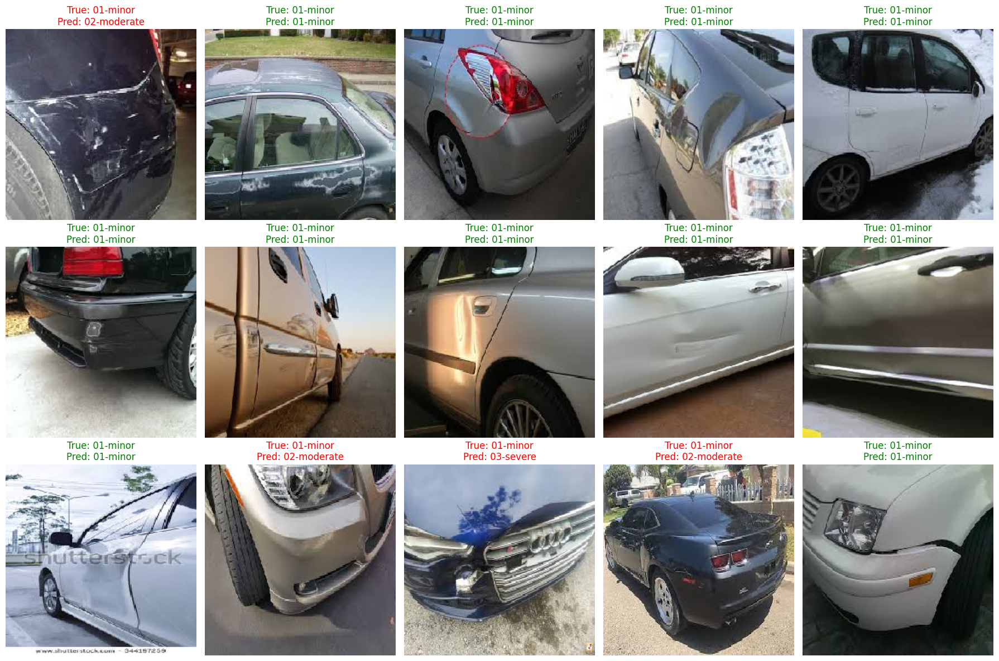


❌ Previsões Incorretas (até 15 exemplos):


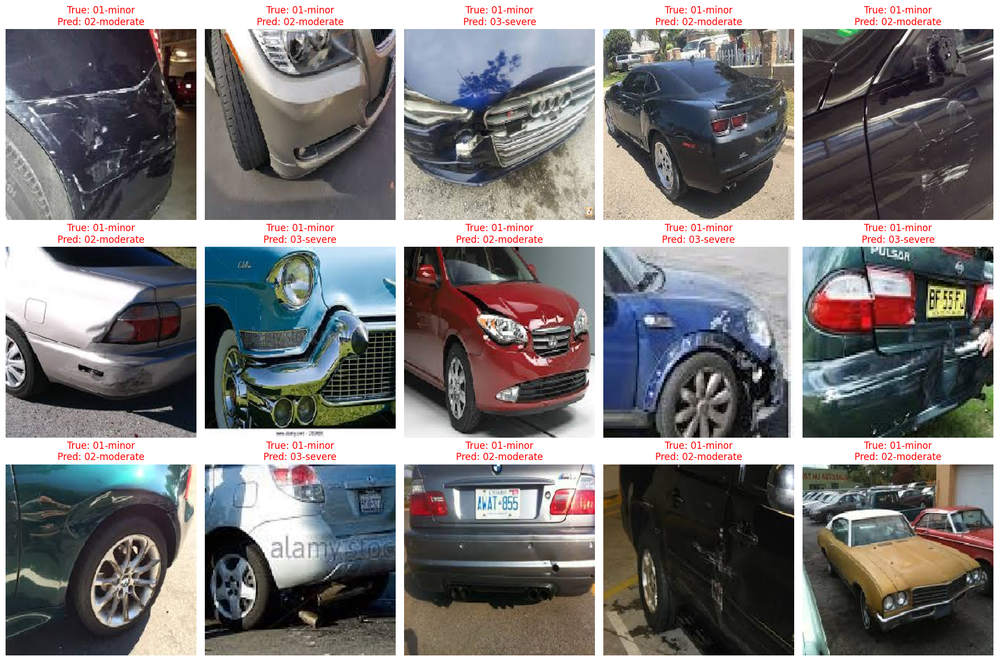

In [14]:
# Caminhos das imagens da validação
filepaths = [os.path.join(val_dir, fname) for fname in val_generator.filenames]

# Função para mostrar previsões
def show_predictions(filepaths, y_true, y_pred, class_names, n=15):
    plt.figure(figsize=(18, 12))
    for i in range(n):
        img = tf.keras.preprocessing.image.load_img(filepaths[i], target_size=IMG_SIZE)
        plt.subplot(3, 5, i + 1)
        plt.imshow(img)
        plt.axis('off')
        true_label = class_names[y_true[i]]
        pred_label = class_names[y_pred[i]]
        color = 'green' if true_label == pred_label else 'red'
        plt.title(f'True: {true_label}\nPred: {pred_label}', color=color)
    plt.tight_layout()
    plt.show()

# Exibir previsões aleatórias
print("\n✅ Previsões Aleatórias da CNN:")
show_predictions(filepaths, y_true, y_pred_classes, class_names, n=15)

# Exibir apenas erros
wrong_indices = np.where(y_true != y_pred_classes)[0]
if len(wrong_indices) > 0:
    print(f"\n❌ Previsões Incorretas (até 15 exemplos):")
    show_predictions([filepaths[i] for i in wrong_indices],
                     [y_true[i] for i in wrong_indices],
                     [y_pred_classes[i] for i in wrong_indices],
                     class_names, n=min(15, len(wrong_indices)))
else:
    print("✅ Nenhum erro encontrado!")

# Convolutional neural network 2 - MobileNetV2

In [15]:
# ===========================================
# 5. Class Weights
# ===========================================
y_train = train_generator.classes
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.unique(y_train),
    y=y_train
)
class_weights_dict = dict(enumerate(class_weights))
print("Pesos das classes:", class_weights_dict)

Pesos das classes: {0: 1.0199115044247788, 1: 0.9956803455723542, 2: 0.9850427350427351}


In [16]:
# ===========================================
# 6. Modelo MobileNetV2 com Fine-Tuning
# ===========================================
base_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Descongela as últimas camadas para fine-tuning
base_model.trainable = True
for layer in base_model.layers[:-30]:
    layer.trainable = False

# Camadas finais customizadas
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(128, activation='relu')(x)
output = Dense(3, activation='softmax')(x)

model = Model(inputs=base_model.input, outputs=output)

model.compile(optimizer=tf.keras.optimizers.Adam(1e-5),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# ===============================
# 6. Callbacks
# ===============================
callbacks = [
    EarlyStopping(patience=5, restore_best_weights=True),
    ModelCheckpoint('mobilenetv2_best.h5', save_best_only=True)
]

#
model.summary()

9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, 112, 112,  │        864 │ input_layer_1[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, 112, 112,  │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, 112, 112,  │          0 │ bn_Conv1[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│ (ReLU)              │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        512 │ expanded_conv_de… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, 112, 112,  │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, 112, 112,  │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, 112, 112,  │          0 │ block_1_expand_B… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, 113, 113,  │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, 56, 56,    │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │          0 │ block_1_depthwis… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, 56, 56,    │      2,304 │ block_1_depthwis

 Total params: 2,422,339 (9.24 MB)

 Trainable params: 1,690,755 (6.45 MB)

 Non-trainable params: 731,584 (2.79 MB)

In [17]:
# ===========================================
# 8. Treinamento
# ===========================================
history = model.fit(
    train_generator,
    validation_data=val_generator,
    epochs=EPOCHS)

Epoch 1/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 57s 773ms/step - accuracy: 0.3517 - loss: 1.1831 - val_accuracy: 0.4758 - val_loss: 1.0530
Epoch 2/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 21s 466ms/step - accuracy: 0.4237 - loss: 1.0709 - val_accuracy: 0.5363 - val_loss: 0.9667
Epoch 3/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 21s 478ms/step - accuracy: 0.5018 - loss: 0.9916 - val_accuracy: 0.5766 - val_loss: 0.9194
Epoch 4/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 21s 479ms/step - accuracy: 0.5257 - loss: 0.9546 - val_accuracy: 0.5887 - val_loss: 0.8844
Epoch 5/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 21s 468ms/step - accuracy: 0.6160 - loss: 0.8814 - val_accuracy: 0.6129 - val_loss: 0.8521
Epoch 6/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 21s 476ms/step - accuracy: 0.5955 - loss: 0.8466 - val_accuracy: 0.6250 - val_loss: 0.8450
Epoch 7/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 21s 475ms/step - accuracy: 0.6038 - loss: 0.8617 - val_accuracy: 0.5927 - val_loss: 0.8312
Epoch 8/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 21s 475ms/step - accuracy: 0.6017 - loss: 0.8280 - 

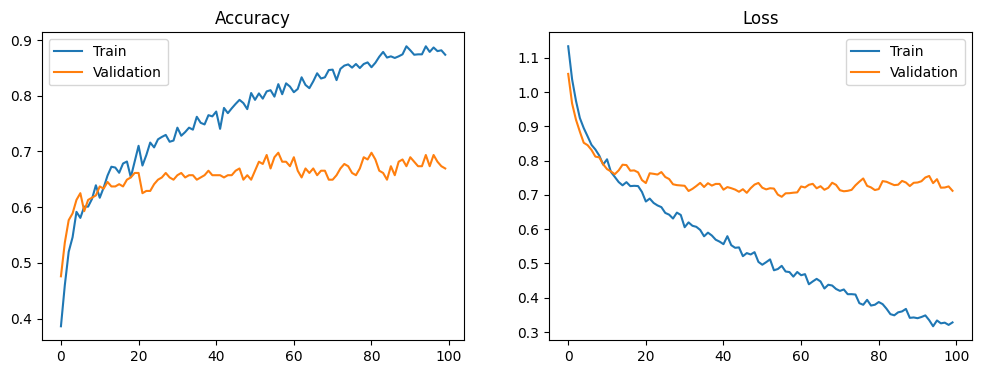

In [18]:
# ===============================
# 8. Avaliação
# ===============================
# Plot Accuracy e Loss
def plot_training_history(history):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Train')
    plt.plot(history.history['val_accuracy'], label='Validation')
    plt.title('Accuracy')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Train')
    plt.plot(history.history['val_loss'], label='Validation')
    plt.title('Loss')
    plt.legend()

    plt.show()

plot_training_history(history)

In [19]:
# Previsões
val_generator.reset()
y_true = val_generator.classes
y_pred = model.predict(val_generator)
y_pred_classes = np.argmax(y_pred, axis=1)

8/8 ━━━━━━━━━━━━━━━━━━━━ 8s 619ms/step


In [20]:
# Relatório de Classificação
print("\nClassification Report:")
print(classification_report(y_true, y_pred_classes, target_names=class_names))


Classification Report:
              precision    recall  f1-score   support

    01-minor       0.73      0.80      0.77        82
 02-moderate       0.47      0.44      0.46        75
   03-severe       0.76      0.74      0.75        91

    accuracy                           0.67       248
   macro avg       0.66      0.66      0.66       248
weighted avg       0.66      0.67      0.67       248



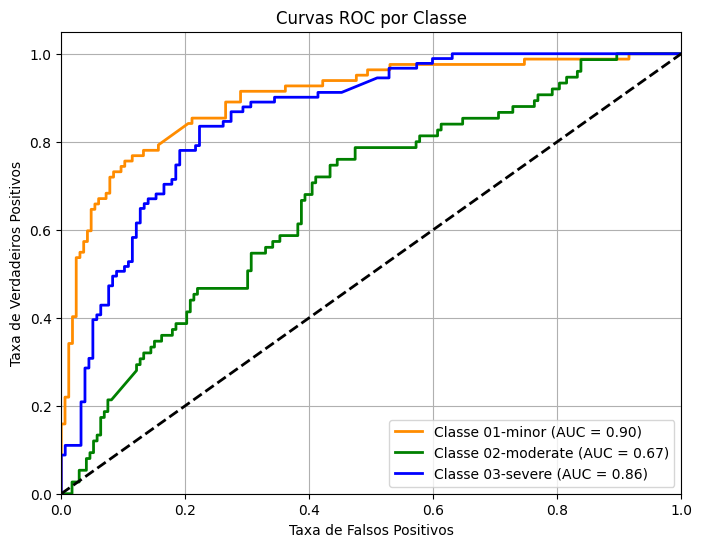

In [21]:
# Número de classes
n_classes = len(class_names)

# Binarizar os rótulos verdadeiros (necessário para ROC)
y_true_bin = label_binarize(y_true, classes=[0, 1, 2])  # classes codificadas em [0, 1, 2]

# Curvas ROC
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_true_bin[:, i], y_pred_probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Cores e estilos para múltiplas classes
colors = cycle(['darkorange', 'green', 'blue'])

# Plot
plt.figure(figsize=(8, 6))
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'Classe {class_names[i]} (AUC = {roc_auc[i]:.2f})')

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Taxa de Falsos Positivos')
plt.ylabel('Taxa de Verdadeiros Positivos')
plt.title('Curvas ROC por Classe')
plt.legend(loc="lower right")
plt.grid()
plt.show()


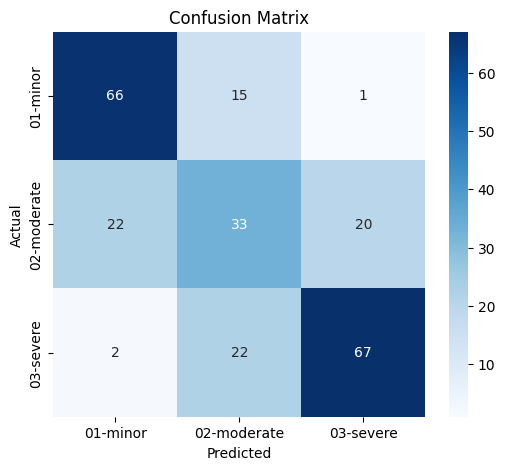

In [22]:
# Matriz de Confusão
cm = confusion_matrix(y_true, y_pred_classes)
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

In [23]:
# Resetar o generator para garantir que ele esteja no começo
val_generator.reset()

# Obter previsões
y_pred_probs = model.predict(val_generator)
y_pred_classes = np.argmax(y_pred_probs, axis=1)
y_true = val_generator.classes
class_names = list(val_generator.class_indices.keys())

# Obter caminhos das imagens da validação
filenames = val_generator.filenames
filepaths = [os.path.join(val_dir, f) for f in filenames]

# ===============================
# Função para mostrar imagens com previsões
# ===============================
def show_predictions(filepaths, y_true, y_pred, class_names, n=15):
    plt.figure(figsize=(18, 12))
    for i in range(n):
        img = tf.keras.preprocessing.image.load_img(filepaths[i], target_size=IMG_SIZE)
        plt.subplot(3, 5, i + 1)
        plt.imshow(img)
        plt.axis('off')
        true_label = class_names[y_true[i]]
        pred_label = class_names[y_pred[i]]
        color = 'green' if true_label == pred_label else 'red'
        plt.title(f'True: {true_label}\nPred: {pred_label}', color=color)
    plt.tight_layout()
    plt.show()

8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 63ms/step


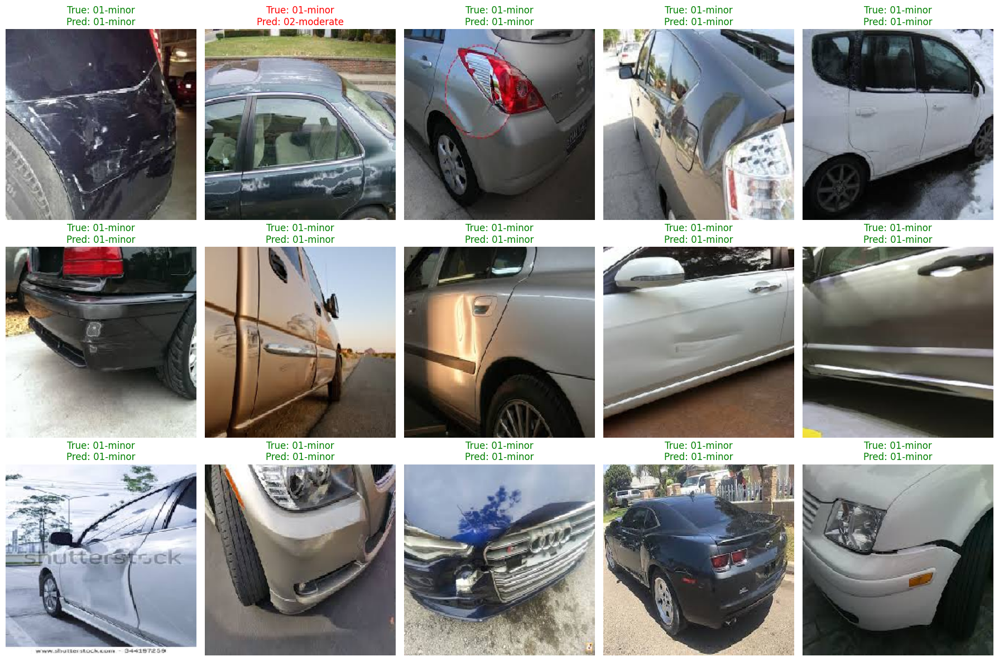

In [24]:
# Exibir previsões
show_predictions(filepaths, y_true, y_pred_classes, class_names, n=15)

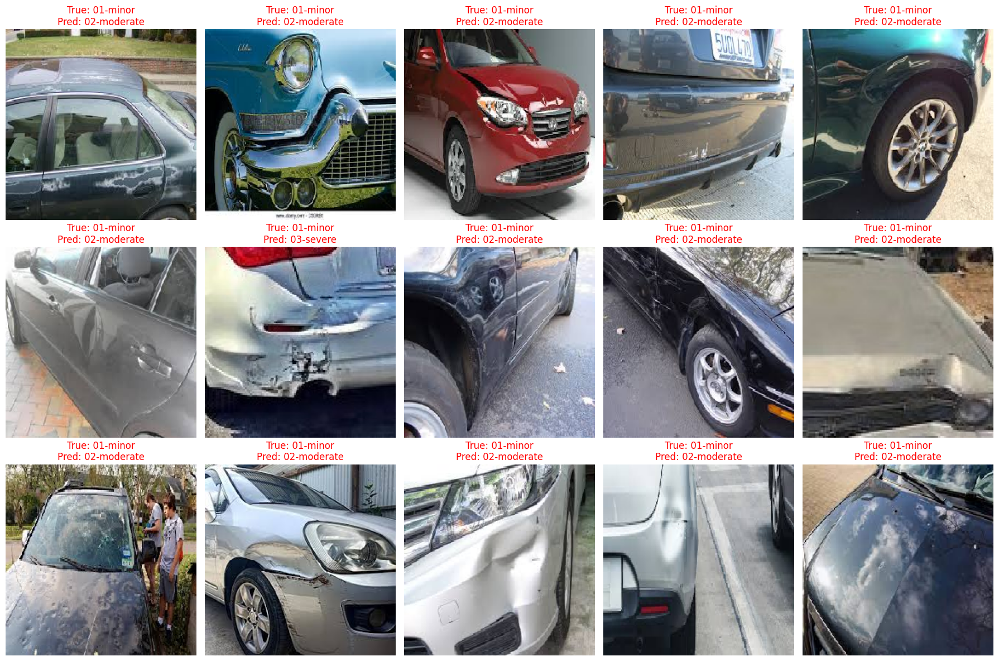

In [25]:
## somente os erros (imagens mal classificadas

# Índices dos erros
wrong_indices = np.where(y_true != y_pred_classes)[0]

# Mostrar os 15 primeiros erros
show_predictions([filepaths[i] for i in wrong_indices],
                 [y_true[i] for i in wrong_indices],
                 [y_pred_classes[i] for i in wrong_indices],
                 class_names, 
                 n=15)


# Convolutional neural network 3 - VGG16

In [26]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import VGG16

# ===========================================
# 6. Modelo VGG16 + Camadas Topo
# ===========================================
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
base_model.trainable = True
for layer in base_model.layers[:-8]:
    layer.trainable = False

x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu')(x)
output = Dense(3, activation='softmax')(x)

model = Model(inputs=base_model.input, outputs=output)

model.compile(optimizer=tf.keras.optimizers.Adam(1e-5),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# ===========================================
# 7. Treinamento
# ===========================================
callbacks = [
    EarlyStopping(patience=5, restore_best_weights=True),
    ModelCheckpoint('vgg16_best.h5', save_best_only=True)
]

#
model.summary()

58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)      │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_1      │ (None, 512)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 3)              │           771 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 14,846,787 (56.64 MB)

 Trainable params: 13,111,299 (50.02 MB)

 Non-trainable params: 1,735,488 (6.62 MB)

In [27]:
# Treinamento CNN
history = model.fit(train_generator,
                    validation_data=val_generator,
                    epochs=EPOCHS)

Epoch 1/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 78s 1s/step - accuracy: 0.4528 - loss: 1.0477 - val_accuracy: 0.6492 - val_loss: 0.8224
Epoch 2/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 24s 529ms/step - accuracy: 0.5967 - loss: 0.8747 - val_accuracy: 0.6573 - val_loss: 0.7203
Epoch 3/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 23s 521ms/step - accuracy: 0.5889 - loss: 0.8370 - val_accuracy: 0.6976 - val_loss: 0.7096
Epoch 4/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 24s 535ms/step - accuracy: 0.6542 - loss: 0.7918 - val_accuracy: 0.6532 - val_loss: 0.7742
Epoch 5/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 24s 532ms/step - accuracy: 0.6248 - loss: 0.8135 - val_accuracy: 0.6855 - val_loss: 0.6969
Epoch 6/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 24s 533ms/step - accuracy: 0.6349 - loss: 0.7956 - val_accuracy: 0.6976 - val_loss: 0.6833
Epoch 7/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 23s 507ms/step - accuracy: 0.6404 - loss: 0.7973 - val_accuracy: 0.7137 - val_loss: 0.6417
Epoch 8/100
44/44 ━━━━━━━━━━━━━━━━━━━━ 24s 546ms/step - accuracy: 0.6919 - loss: 0.7196 - val

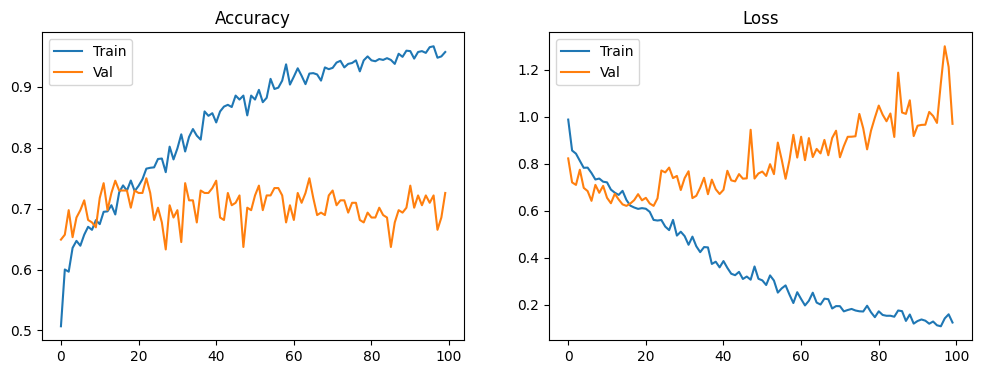

In [28]:
# ===========================================
# 8. Avaliação
# ===========================================
def plot_history(history):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Train')
    plt.plot(history.history['val_accuracy'], label='Val')
    plt.title("Accuracy")
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Train')
    plt.plot(history.history['val_loss'], label='Val')
    plt.title("Loss")
    plt.legend()

    plt.show()

plot_history(history)

In [29]:
# Previsões
val_generator.reset()
y_true = val_generator.classes
y_pred_probs = model.predict(val_generator)
y_pred_classes = np.argmax(y_pred_probs, axis=1)

8/8 ━━━━━━━━━━━━━━━━━━━━ 3s 300ms/step


In [30]:
# Classification Report
print("Classification Report:")
print(classification_report(y_true, y_pred_classes, target_names=class_names))

Classification Report:
              precision    recall  f1-score   support

    01-minor       0.82      0.77      0.79        82
 02-moderate       0.55      0.51      0.53        75
   03-severe       0.77      0.87      0.82        91

    accuracy                           0.73       248
   macro avg       0.71      0.71      0.71       248
weighted avg       0.72      0.73      0.72       248



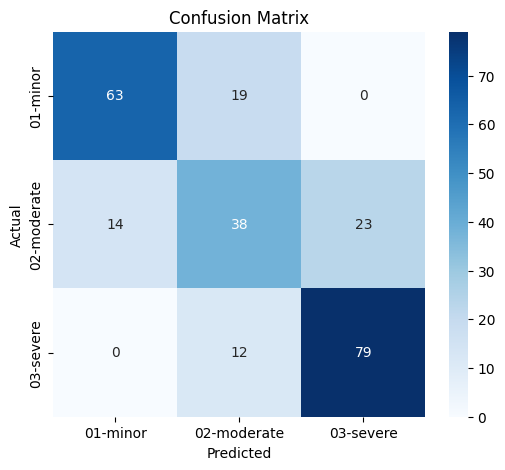

In [31]:
# Confusion Matrix
cm = confusion_matrix(y_true, y_pred_classes)
plt.figure(figsize=(6,5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

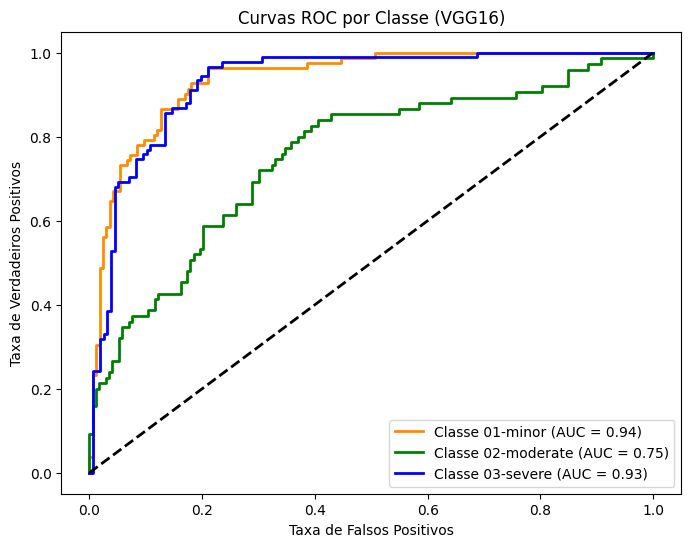

In [32]:
# ===========================================
# 9. Curvas ROC por Classe
# ===========================================
y_true_bin = label_binarize(y_true, classes=[0, 1, 2])
fpr, tpr, roc_auc = {}, {}, {}

for i in range(3):
    fpr[i], tpr[i], _ = roc_curve(y_true_bin[:, i], y_pred_probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

colors = cycle(['darkorange', 'green', 'blue'])
plt.figure(figsize=(8, 6))

for i, color in zip(range(3), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2,
             label=f'Classe {class_names[i]} (AUC = {roc_auc[i]:.2f})')

plt.plot([0, 1], [0, 1], 'k--', lw=2)
plt.xlabel('Taxa de Falsos Positivos')
plt.ylabel('Taxa de Verdadeiros Positivos')
plt.title('Curvas ROC por Classe (VGG16)')
plt.legend(loc="lower right")
plt.grid(False)
plt.show()


🔍 Previsões Aleatórias (corretas e incorretas):


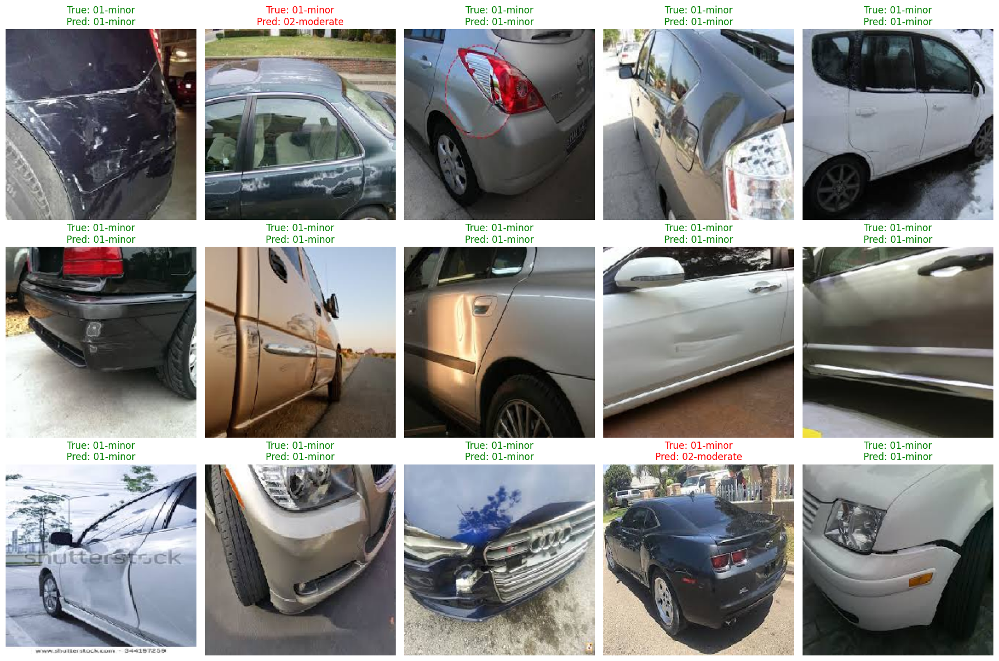


❌ Previsões Incorretas (mostrando até 15):


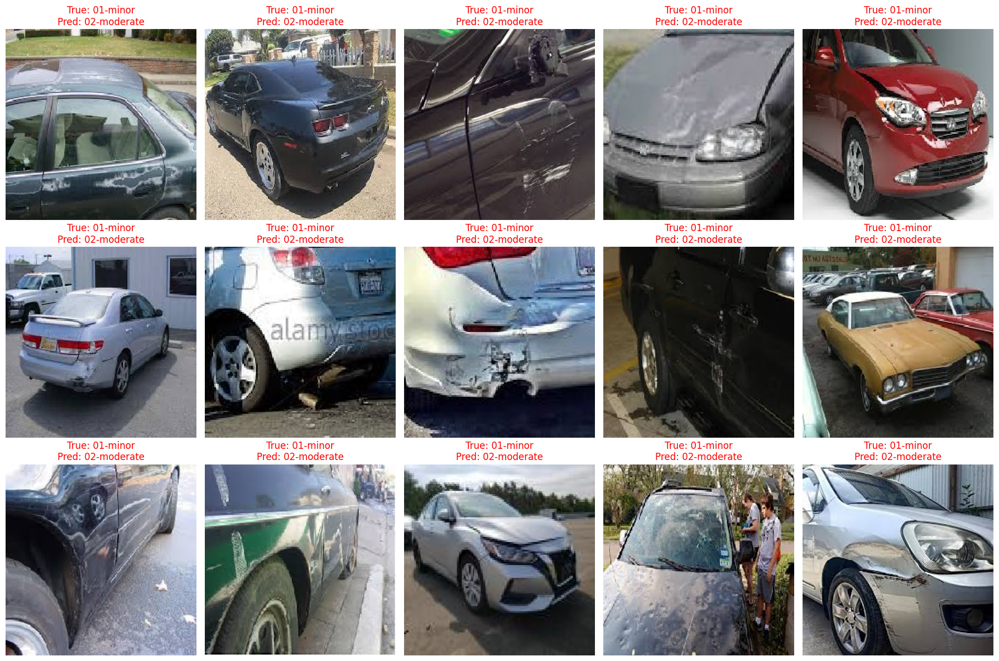

In [33]:
# ===========================================
# 10. Visualização de Previsões com VGG16
# ===========================================
# Caminhos das imagens
filepaths = [os.path.join(val_dir, fname) for fname in val_generator.filenames]

# Função para mostrar previsões
def show_predictions(filepaths, y_true, y_pred, class_names, n=15):
    plt.figure(figsize=(18, 12))
    for i in range(n):
        img = tf.keras.preprocessing.image.load_img(filepaths[i], target_size=IMG_SIZE)
        plt.subplot(3, 5, i + 1)
        plt.imshow(img)
        plt.axis('off')
        true_label = class_names[y_true[i]]
        pred_label = class_names[y_pred[i]]
        color = 'green' if true_label == pred_label else 'red'
        plt.title(f'True: {true_label}\nPred: {pred_label}', color=color)
    plt.tight_layout()
    plt.show()

# Previsões aleatórias
print("\n🔍 Previsões Aleatórias (corretas e incorretas):")
show_predictions(filepaths, y_true, y_pred_classes, class_names, n=15)

# Mostrar apenas os erros
wrong_indices = np.where(y_true != y_pred_classes)[0]
if len(wrong_indices) > 0:
    print(f"\n❌ Previsões Incorretas (mostrando até 15):")
    show_predictions([filepaths[i] for i in wrong_indices],
                     [y_true[i] for i in wrong_indices],
                     [y_pred_classes[i] for i in wrong_indices],
                     class_names, n=min(15, len(wrong_indices)))
else:
    print("✅ Nenhum erro encontrado!")


# Modelo 4 - Yolo Reconhecimento

In [34]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 19.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 83.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 61.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 48.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 25.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 12.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 65.5 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling

In [35]:
import os
import shutil
from PIL import Image
from tqdm import tqdm
from ultralytics import YOLO

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [36]:
# Diretórios de entrada
source_root = "/kaggle/input/car-damage-severity-dataset/data3a"
target_root = "/kaggle/working/car_damage_yolo"

# Mapeamento de classes
class_mapping = {
    "01-minor": 0,
    "02-moderate": 1,
    "03-severe": 2
}

# Criação da estrutura YOLO (images/ e labels/)
for split in ["train", "val"]:
    os.makedirs(f"{target_root}/images/{split}", exist_ok=True)
    os.makedirs(f"{target_root}/labels/{split}", exist_ok=True)

    for class_folder in class_mapping.keys():
        class_id = class_mapping[class_folder]
        img_dir = os.path.join(source_root, "training" if split=="train" else "validation", class_folder)
        img_files = [f for f in os.listdir(img_dir) if f.lower().endswith((".jpg", ".jpeg", ".png"))]

        for img_file in tqdm(img_files, desc=f"{split} - {class_folder}"):
            src_img = os.path.join(img_dir, img_file)
            dst_img = os.path.join(f"{target_root}/images/{split}", img_file)
            dst_txt = os.path.join(f"{target_root}/labels/{split}", img_file.rsplit(".", 1)[0] + ".txt")

            # Copia imagem
            shutil.copyfile(src_img, dst_img)

            # Cria bounding box central (falsa)
            with Image.open(src_img) as im:
                w, h = im.size
            x_center, y_center = 0.5, 0.5
            box_width, box_height = 0.8, 0.8

            with open(dst_txt, "w") as f:
                f.write(f"{class_id} {x_center} {y_center} {box_width} {box_height}\n")

val - 03-severe: 100%|██████████| 91/91 [00:00<00:00, 564.85it/s]


In [37]:
data_yaml = """
path: /kaggle/working/car_damage_yolo
train: images/train
val: images/val

names:
  0: minor
  1: moderate
  2: severe
"""

with open("/kaggle/working/car_damage_yolo/data.yaml", "w") as f:
    f.write(data_yaml)


In [38]:
# Modelo yolo
model = YOLO("yolov8n.pt")  # ou yolov8s.pt para versão mais robusta

100%|██████████| 6.25M/6.25M [00:00<00:00, 86.0MB/s]


In [39]:
# Treinamento modelo
model.train(data="/kaggle/working/car_damage_yolo/data.yaml",
            epochs=100,
            imgsz=640,
            batch=16,
            name="car_damage_detector")

Ultralytics 8.3.167 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/kaggle/working/car_damage_yolo/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=car_damage_detector, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots

100%|██████████| 755k/755k [00:00<00:00, 17.9MB/s]


Overriding model.yaml nc=80 with nc=3

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 73.3MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 291.3±108.2 MB/s, size: 8.5 KB)


train: Scanning /kaggle/working/car_damage_yolo/labels/train... 712 images, 0 backgrounds, 0 corrupt: 100%|██████████| 712/712 [00:00<00:00, 1360.76it/s]

train: New cache created: /kaggle/working/car_damage_yolo/labels/train.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 161.1±75.0 MB/s, size: 7.2 KB)


val: Scanning /kaggle/working/car_damage_yolo/labels/val... 153 images, 0 backgrounds, 0 corrupt: 100%|██████████| 153/153 [00:00<00:00, 1647.04it/s]

val: New cache created: /kaggle/working/car_damage_yolo/labels/val.cache


Plotting labels to runs/detect/car_damage_detector/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/car_damage_detector
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      2.03G      1.154      2.264      1.667         19        640: 100%|██████████| 45/45 [00:09<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  2.29it/s]

                   all        153        153      0.637      0.304      0.321      0.197



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      2.41G     0.7531      1.505      1.245         19        640: 100%|██████████| 45/45 [00:07<00:00,  5.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.65it/s]


                   all        153        153      0.315      0.551      0.376      0.271

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      2.43G      0.762      1.383      1.229         18        640: 100%|██████████| 45/45 [00:07<00:00,  5.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.22it/s]


                   all        153        153      0.338       0.73      0.463       0.37

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      2.45G     0.7336      1.225      1.205         25        640: 100%|██████████| 45/45 [00:07<00:00,  6.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.73it/s]


                   all        153        153       0.39      0.523      0.439       0.36

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      2.46G     0.6649      1.102      1.181         24        640: 100%|██████████| 45/45 [00:07<00:00,  6.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.40it/s]


                   all        153        153      0.482      0.518      0.487      0.403

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      2.48G     0.6311      1.072      1.158         23        640: 100%|██████████| 45/45 [00:07<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.03it/s]


                   all        153        153      0.347      0.754      0.476      0.427

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100       2.5G      0.636      1.028      1.158         23        640: 100%|██████████| 45/45 [00:07<00:00,  5.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.42it/s]

                   all        153        153      0.447      0.773      0.495      0.451



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      2.52G     0.6128     0.9937      1.146         28        640: 100%|██████████| 45/45 [00:07<00:00,  6.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.27it/s]

                   all        153        153      0.405      0.664      0.488      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      2.53G     0.6086     0.9522      1.151         28        640: 100%|██████████| 45/45 [00:07<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.53it/s]

                   all        153        153      0.489      0.713      0.587      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      2.55G     0.5915     0.9395      1.115         27        640: 100%|██████████| 45/45 [00:07<00:00,  6.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.37it/s]

                   all        153        153      0.393      0.697      0.492      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      2.57G      0.603     0.9195       1.14         23        640: 100%|██████████| 45/45 [00:07<00:00,  5.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.09it/s]

                   all        153        153      0.446       0.58      0.537      0.468



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      2.58G     0.6052     0.9413       1.15         15        640: 100%|██████████| 45/45 [00:07<00:00,  6.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.30it/s]

                   all        153        153      0.446      0.642      0.599      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100       2.6G     0.5683     0.8785      1.111         26        640: 100%|██████████| 45/45 [00:07<00:00,  5.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.29it/s]

                   all        153        153      0.515      0.661      0.576      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      2.62G     0.5678     0.8636      1.119         19        640: 100%|██████████| 45/45 [00:07<00:00,  6.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.94it/s]

                   all        153        153       0.47      0.838      0.576       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      2.63G     0.5608     0.8471       1.12         23        640: 100%|██████████| 45/45 [00:07<00:00,  6.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.07it/s]

                   all        153        153      0.411      0.726      0.505      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      2.65G     0.5479     0.8257      1.104         26        640: 100%|██████████| 45/45 [00:07<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.94it/s]

                   all        153        153      0.509      0.738      0.557      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      2.66G     0.5415      0.806      1.088         26        640: 100%|██████████| 45/45 [00:07<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.49it/s]

                   all        153        153      0.474      0.666      0.576      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      2.69G     0.5242     0.8104      1.086         19        640: 100%|██████████| 45/45 [00:07<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.54it/s]

                   all        153        153      0.512       0.66       0.51      0.457



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100       2.7G     0.5145     0.8093      1.078         25        640: 100%|██████████| 45/45 [00:07<00:00,  6.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.81it/s]

                   all        153        153      0.398      0.674      0.541      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      2.72G     0.5198     0.8268      1.078         25        640: 100%|██████████| 45/45 [00:07<00:00,  5.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.63it/s]

                   all        153        153      0.472      0.683      0.541      0.512



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      2.73G     0.5015     0.7902      1.067         20        640: 100%|██████████| 45/45 [00:07<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.32it/s]

                   all        153        153      0.486      0.778      0.603      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      2.76G     0.5204     0.7884        1.1         17        640: 100%|██████████| 45/45 [00:07<00:00,  5.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.72it/s]

                   all        153        153      0.465      0.591      0.546      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      2.77G     0.5337     0.7938      1.091         22        640: 100%|██████████| 45/45 [00:07<00:00,  5.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.15it/s]

                   all        153        153      0.484      0.664      0.528      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      2.79G     0.5151      0.802       1.08         27        640: 100%|██████████| 45/45 [00:07<00:00,  5.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.30it/s]

                   all        153        153      0.477      0.743      0.537      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100       2.8G     0.4963     0.8051      1.073         25        640: 100%|██████████| 45/45 [00:07<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.39it/s]

                   all        153        153      0.473      0.745      0.517      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      2.82G     0.4832     0.7632      1.056         23        640: 100%|██████████| 45/45 [00:07<00:00,  5.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.51it/s]

                   all        153        153       0.52      0.577      0.549      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      2.84G     0.5058     0.7622      1.071         27        640: 100%|██████████| 45/45 [00:07<00:00,  6.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.19it/s]

                   all        153        153      0.526      0.717       0.61      0.588



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      2.86G      0.469     0.7571      1.053         29        640: 100%|██████████| 45/45 [00:07<00:00,  5.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.26it/s]

                   all        153        153      0.408      0.809      0.511      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      2.87G     0.4919     0.7472      1.067         26        640: 100%|██████████| 45/45 [00:07<00:00,  6.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.30it/s]

                   all        153        153      0.466      0.615      0.583      0.543



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      2.89G     0.4819     0.7367      1.058         26        640: 100%|██████████| 45/45 [00:07<00:00,  5.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.19it/s]

                   all        153        153      0.527      0.703       0.57      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      2.91G      0.472     0.7629      1.051         22        640: 100%|██████████| 45/45 [00:07<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.19it/s]

                   all        153        153      0.438      0.791      0.494      0.468



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      2.93G     0.4727     0.7302      1.052         23        640: 100%|██████████| 45/45 [00:07<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.12it/s]

                   all        153        153       0.46      0.738      0.565      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      2.94G     0.4713      0.726      1.055         23        640: 100%|██████████| 45/45 [00:07<00:00,  6.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.03it/s]

                   all        153        153      0.551      0.692      0.617      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      2.96G     0.4688     0.7242      1.051         22        640: 100%|██████████| 45/45 [00:07<00:00,  6.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.42it/s]

                   all        153        153      0.582      0.671      0.675      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      2.98G     0.4639     0.7255      1.054         28        640: 100%|██████████| 45/45 [00:07<00:00,  5.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.15it/s]

                   all        153        153      0.522      0.702      0.618      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      2.99G     0.4645     0.7089      1.052         27        640: 100%|██████████| 45/45 [00:07<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.46it/s]

                   all        153        153      0.433       0.71      0.486      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100         3G     0.4322     0.6944      1.037         21        640: 100%|██████████| 45/45 [00:07<00:00,  5.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.45it/s]

                   all        153        153      0.467      0.761       0.57      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      3.03G     0.4563     0.7058      1.042         26        640: 100%|██████████| 45/45 [00:07<00:00,  6.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.27it/s]

                   all        153        153      0.494       0.85      0.638       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      3.04G     0.4539     0.6891      1.043         22        640: 100%|██████████| 45/45 [00:07<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.47it/s]

                   all        153        153      0.491      0.793      0.548      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      3.06G     0.4468     0.6907      1.044         24        640: 100%|██████████| 45/45 [00:07<00:00,  6.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.20it/s]

                   all        153        153      0.435      0.857      0.521      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      3.07G     0.4521     0.7003       1.04         26        640: 100%|██████████| 45/45 [00:07<00:00,  5.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.36it/s]

                   all        153        153       0.44      0.841      0.484      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100       3.1G     0.4667     0.6926      1.052         26        640: 100%|██████████| 45/45 [00:07<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.24it/s]

                   all        153        153      0.472      0.801      0.563      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      3.11G     0.4529     0.6977      1.062         21        640: 100%|██████████| 45/45 [00:07<00:00,  5.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.38it/s]

                   all        153        153      0.463      0.861      0.582      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      3.13G     0.4325     0.6435       1.03         23        640: 100%|██████████| 45/45 [00:07<00:00,  6.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.69it/s]

                   all        153        153       0.54      0.736      0.594      0.576



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      3.14G     0.4432     0.6838      1.039         26        640: 100%|██████████| 45/45 [00:07<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.45it/s]

                   all        153        153      0.431      0.781      0.473       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      3.16G     0.4161     0.6541      1.027         21        640: 100%|██████████| 45/45 [00:07<00:00,  5.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.22it/s]

                   all        153        153      0.431      0.795      0.501      0.483



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      3.18G     0.4269     0.6489      1.034         19        640: 100%|██████████| 45/45 [00:07<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.35it/s]

                   all        153        153      0.505      0.785      0.593      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100       3.2G     0.4281     0.6646      1.035         21        640: 100%|██████████| 45/45 [00:07<00:00,  5.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.50it/s]

                   all        153        153       0.49      0.839      0.525       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      3.21G     0.4145      0.642      1.026         19        640: 100%|██████████| 45/45 [00:07<00:00,  6.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.34it/s]

                   all        153        153      0.471      0.799       0.51      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      3.23G     0.4345     0.6377      1.033         23        640: 100%|██████████| 45/45 [00:07<00:00,  5.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.47it/s]

                   all        153        153      0.467      0.808      0.491      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      3.25G     0.4098     0.6259      1.022         25        640: 100%|██████████| 45/45 [00:07<00:00,  6.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.96it/s]

                   all        153        153      0.425      0.882      0.485      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      3.27G     0.4115      0.639      1.024         25        640: 100%|██████████| 45/45 [00:07<00:00,  5.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.50it/s]

                   all        153        153      0.433      0.893      0.479      0.468



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      3.28G     0.3977     0.6273      1.024         24        640: 100%|██████████| 45/45 [00:07<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.32it/s]

                   all        153        153      0.503      0.694      0.574      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100       3.3G     0.4207     0.6158      1.022         24        640: 100%|██████████| 45/45 [00:07<00:00,  5.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.95it/s]

                   all        153        153      0.503      0.659      0.548      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      3.32G     0.3921     0.5928      1.018         21        640: 100%|██████████| 45/45 [00:07<00:00,  6.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.03it/s]

                   all        153        153       0.52      0.779       0.58      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      3.34G       0.39     0.6027      1.008         24        640: 100%|██████████| 45/45 [00:07<00:00,  5.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.53it/s]

                   all        153        153      0.454       0.73       0.49      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      3.35G     0.4078     0.6074      1.021         15        640: 100%|██████████| 45/45 [00:07<00:00,  6.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.18it/s]


                   all        153        153      0.426      0.829      0.567      0.557

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      3.37G     0.4167     0.5991       1.02         16        640: 100%|██████████| 45/45 [00:07<00:00,  5.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.87it/s]

                   all        153        153       0.43      0.876      0.499      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      3.39G     0.4121      0.602      1.028         15        640: 100%|██████████| 45/45 [00:07<00:00,  6.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.46it/s]

                   all        153        153      0.665      0.618      0.662      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100       3.4G     0.4151      0.601      1.018         19        640: 100%|██████████| 45/45 [00:07<00:00,  6.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.28it/s]

                   all        153        153       0.48      0.799      0.531      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      3.42G      0.387     0.6098      1.003         22        640: 100%|██████████| 45/45 [00:07<00:00,  6.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.45it/s]

                   all        153        153      0.487      0.843      0.563      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      3.44G     0.3935        0.6       1.02         24        640: 100%|██████████| 45/45 [00:07<00:00,  6.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.75it/s]

                   all        153        153      0.512      0.712      0.603      0.598



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      3.46G     0.3887      0.614      1.017         22        640: 100%|██████████| 45/45 [00:07<00:00,  5.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.40it/s]

                   all        153        153      0.453      0.806      0.486      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      3.47G     0.4001      0.594       1.02         24        640: 100%|██████████| 45/45 [00:07<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.58it/s]

                   all        153        153      0.438      0.861      0.549       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      3.48G     0.3895     0.5952      1.013         24        640: 100%|██████████| 45/45 [00:07<00:00,  5.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.10it/s]

                   all        153        153      0.499      0.761      0.596      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      3.51G     0.3778     0.5688      1.009         26        640: 100%|██████████| 45/45 [00:07<00:00,  6.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.05it/s]

                   all        153        153      0.525      0.721      0.547      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      3.52G     0.3693     0.5523      1.005         26        640: 100%|██████████| 45/45 [00:07<00:00,  5.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.11it/s]

                   all        153        153      0.486      0.799      0.521      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      3.54G     0.3802     0.5462      1.009         19        640: 100%|██████████| 45/45 [00:07<00:00,  6.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.35it/s]

                   all        153        153      0.517      0.798      0.554      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      3.55G     0.3944     0.5637      1.019         26        640: 100%|██████████| 45/45 [00:07<00:00,  5.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.45it/s]

                   all        153        153      0.491      0.814      0.539       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      3.57G     0.3731     0.5689      1.006         22        640: 100%|██████████| 45/45 [00:07<00:00,  6.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.95it/s]

                   all        153        153      0.489      0.753      0.542      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      3.59G     0.3723     0.5463     0.9974         23        640: 100%|██████████| 45/45 [00:07<00:00,  5.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.24it/s]

                   all        153        153      0.518      0.681      0.564      0.557



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      3.61G     0.3694     0.5446      1.013         16        640: 100%|██████████| 45/45 [00:07<00:00,  6.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.45it/s]

                   all        153        153      0.412      0.839      0.453      0.446



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      3.62G     0.3747     0.5454      1.014         23        640: 100%|██████████| 45/45 [00:07<00:00,  5.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  6.05it/s]

                   all        153        153      0.576      0.648      0.626      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      3.64G     0.3648     0.5199      1.001         31        640: 100%|██████████| 45/45 [00:07<00:00,  6.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.23it/s]

                   all        153        153      0.427      0.847      0.495      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      3.66G     0.3636     0.5322      1.006         26        640: 100%|██████████| 45/45 [00:07<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.43it/s]

                   all        153        153      0.472      0.723      0.507      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      3.68G     0.3637     0.5264      1.003         27        640: 100%|██████████| 45/45 [00:07<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.70it/s]

                   all        153        153      0.473      0.778      0.511      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      3.69G     0.3454     0.5104     0.9956         19        640: 100%|██████████| 45/45 [00:07<00:00,  6.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.06it/s]

                   all        153        153      0.432      0.737       0.49      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      3.71G     0.3591     0.5031     0.9974         28        640: 100%|██████████| 45/45 [00:07<00:00,  6.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.16it/s]

                   all        153        153      0.462      0.854      0.535      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      3.73G     0.3529     0.4977     0.9947         19        640: 100%|██████████| 45/45 [00:07<00:00,  6.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.29it/s]

                   all        153        153      0.582      0.617      0.556      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      3.75G     0.3781       0.52      1.012         17        640: 100%|██████████| 45/45 [00:07<00:00,  5.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.42it/s]

                   all        153        153      0.492      0.758      0.506      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      3.76G     0.3497     0.5026     0.9906         28        640: 100%|██████████| 45/45 [00:07<00:00,  6.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.92it/s]

                   all        153        153      0.549      0.765      0.576      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      3.78G     0.3492     0.4878     0.9888         24        640: 100%|██████████| 45/45 [00:07<00:00,  5.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.43it/s]

                   all        153        153      0.476      0.713      0.492      0.491



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100       3.8G     0.3592     0.4653      1.002         28        640: 100%|██████████| 45/45 [00:07<00:00,  6.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.29it/s]

                   all        153        153      0.451      0.803      0.514       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      3.81G     0.3637      0.458     0.9971         20        640: 100%|██████████| 45/45 [00:07<00:00,  5.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.51it/s]

                   all        153        153      0.507      0.772      0.536      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      3.82G     0.3558     0.4812     0.9989         24        640: 100%|██████████| 45/45 [00:07<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.38it/s]

                   all        153        153      0.506      0.748        0.6      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      3.85G     0.3516     0.4724      1.006         25        640: 100%|██████████| 45/45 [00:07<00:00,  5.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.29it/s]

                   all        153        153      0.453       0.81      0.491      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      3.87G     0.3457     0.4573     0.9823         23        640: 100%|██████████| 45/45 [00:07<00:00,  6.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.05it/s]


                   all        153        153      0.485        0.8      0.519      0.515

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      3.88G     0.3476     0.4766     0.9923         25        640: 100%|██████████| 45/45 [00:07<00:00,  6.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.62it/s]

                   all        153        153      0.454      0.841      0.522      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      3.89G     0.3442     0.4894     0.9977         25        640: 100%|██████████| 45/45 [00:07<00:00,  6.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.80it/s]

                   all        153        153      0.527       0.73      0.553       0.55



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      3.92G     0.3457     0.4696     0.9979         19        640: 100%|██████████| 45/45 [00:07<00:00,  6.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.55it/s]

                   all        153        153       0.51      0.751      0.533      0.532


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      3.93G     0.3948     0.4697      1.146          8        640: 100%|██████████| 45/45 [00:08<00:00,  5.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.75it/s]

                   all        153        153      0.461       0.74      0.496      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      3.95G     0.3457      0.397      1.106          8        640: 100%|██████████| 45/45 [00:07<00:00,  6.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  5.00it/s]

                   all        153        153      0.449      0.782      0.514      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      3.96G     0.3261     0.3973      1.099          8        640: 100%|██████████| 45/45 [00:07<00:00,  6.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.28it/s]

                   all        153        153      0.495      0.729       0.52      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      3.98G     0.3059     0.3348      1.067          8        640: 100%|██████████| 45/45 [00:07<00:00,  6.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.62it/s]

                   all        153        153      0.463      0.762      0.512      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100         4G      0.315     0.3488      1.083          8        640: 100%|██████████| 45/45 [00:07<00:00,  6.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.42it/s]

                   all        153        153      0.515      0.742      0.547      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      4.02G     0.2975     0.3224      1.048          8        640: 100%|██████████| 45/45 [00:07<00:00,  6.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  4.81it/s]

                   all        153        153      0.491      0.781      0.552      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      4.03G     0.2926     0.3158      1.048          8        640: 100%|██████████| 45/45 [00:07<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.44it/s]

                   all        153        153      0.551      0.785      0.584      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      4.05G     0.2897     0.2967      1.054          8        640: 100%|██████████| 45/45 [00:07<00:00,  6.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.59it/s]

                   all        153        153      0.518      0.778      0.576      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      4.07G     0.2869     0.2972      1.048          8        640: 100%|██████████| 45/45 [00:07<00:00,  5.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.20it/s]

                   all        153        153      0.509      0.739      0.545      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      4.09G     0.2628     0.2961      1.013          8        640: 100%|██████████| 45/45 [00:07<00:00,  6.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:00<00:00,  5.36it/s]

                   all        153        153      0.474      0.773      0.536      0.536



100 epochs completed in 0.242 hours.
Optimizer stripped from runs/detect/car_damage_detector/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/car_damage_detector/weights/best.pt, 6.3MB

Validating runs/detect/car_damage_detector/weights/best.pt...
Ultralytics 8.3.167 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,006,233 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:01<00:00,  3.13it/s]
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all        153        153      0.586      0.667      0.675      0.643
                 minor         31         31      0.538      0.489      0.598      0.552
              moderate         20         20      0.391        0.6      0.516      0.497
                severe        102        102      0.829      0.912       0.91       0.88
Speed: 0.2ms preprocess, 1.8ms inference, 0.0ms loss, 3.3ms postprocess per image
Results saved to runs/detect/car_damage_detector


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7d1dacef3990>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.04

In [40]:
# Usar melhor modelo após treino
model = YOLO("runs/detect/car_damage_detector/weights/best.pt")

# Prever em uma imagem da validação
results = model.predict(source="/kaggle/working/car_damage_yolo/images/val", 
                        conf=0.10,
                        save=True)


image 1/153 /kaggle/working/car_damage_yolo/images/val/0001.JPEG: 512x640 1 severe, 45.6ms
image 2/153 /kaggle/working/car_damage_yolo/images/val/0002.JPEG: 480x640 1 severe, 45.7ms
image 3/153 /kaggle/working/car_damage_yolo/images/val/0003.JPEG: 448x640 1 severe, 46.6ms
image 4/153 /kaggle/working/car_damage_yolo/images/val/0004.JPEG: 608x640 1 severe, 45.6ms
image 5/153 /kaggle/working/car_damage_yolo/images/val/0005.JPEG: 480x640 1 severe, 8.4ms
image 6/153 /kaggle/working/car_damage_yolo/images/val/0006.JPEG: 576x640 1 severe, 46.4ms
image 7/153 /kaggle/working/car_damage_yolo/images/val/0007.JPEG: 256x640 1 severe, 45.9ms
image 8/153 /kaggle/working/car_damage_yolo/images/val/0008.JPEG: 384x640 1 severe, 46.0ms
image 9/153 /kaggle/working/car_damage_yolo/images/val/0008.jpeg: 480x640 1 severe, 8.1ms
image 10/153 /kaggle/working/car_damage_yolo/images/val/0009.JPEG: 480x640 1 severe, 7.4ms
image 11/153 /kaggle/working/car_damage_yolo/images/val/0009.jpeg: 640x480 1 minor, 45.6ms


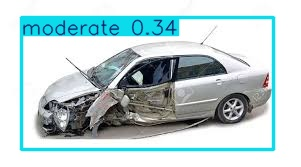

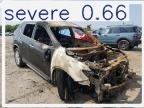

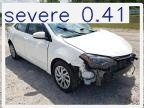

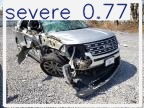

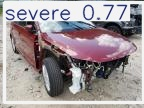

...

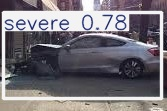

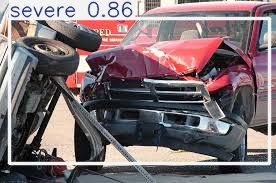

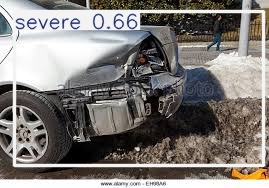

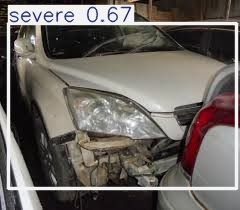

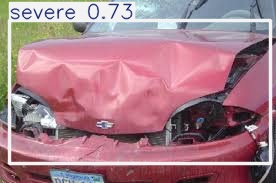

In [41]:
from IPython.display import Image, display
import glob

predicted_images = glob.glob('/kaggle/working/runs/detect/predict/*.jpg')

for img_path in predicted_images[:30]:
    display(Image(filename=img_path))

In [42]:
from ultralytics import YOLO
from PIL import Image
from IPython.display import display
from glob import glob
import os

# Lista de caminhos das 3 imagens para prever
img_paths = [
    "/kaggle/input/car-damage-severity-dataset/data3a/validation/01-minor/0004.JPEG",
    "/kaggle/input/car-damage-severity-dataset/data3a/validation/02-moderate/0015.jpeg",
    "/kaggle/input/car-damage-severity-dataset/data3a/validation/03-severe/0028.JPEG"
]

# Carregar o modelo YOLO treinado (ajuste o caminho se necessário)
model = YOLO("runs/detect/car_damage_detector/weights/best.pt")

Fazendo predição para: /kaggle/input/car-damage-severity-dataset/data3a/validation/01-minor/0004.JPEG

image 1/1 /kaggle/input/car-damage-severity-dataset/data3a/validation/01-minor/0004.JPEG: 480x640 1 severe, 10.0ms
Speed: 1.8ms preprocess, 10.0ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/detect/predict2


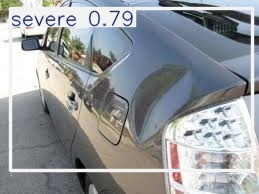

Fazendo predição para: /kaggle/input/car-damage-severity-dataset/data3a/validation/02-moderate/0015.jpeg

image 1/1 /kaggle/input/car-damage-severity-dataset/data3a/validation/02-moderate/0015.jpeg: 448x640 1 severe, 8.3ms
Speed: 1.8ms preprocess, 8.3ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict2


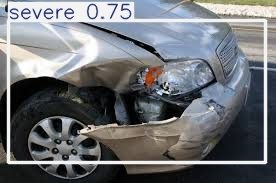

Fazendo predição para: /kaggle/input/car-damage-severity-dataset/data3a/validation/03-severe/0028.JPEG

image 1/1 /kaggle/input/car-damage-severity-dataset/data3a/validation/03-severe/0028.JPEG: 480x640 1 severe, 8.2ms
Speed: 1.8ms preprocess, 8.2ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/detect/predict2


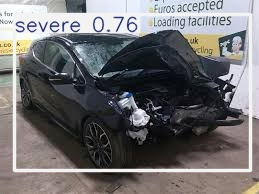

In [43]:
# Loop para prever e mostrar cada imagem
for img_path in img_paths:
    print(f"Fazendo predição para: {img_path}")
    
    results = model.predict(source=img_path, conf=0.4, save=True)

    # Buscar imagem salva com boxes
    saved_imgs = glob(f"{results[0].save_dir}/*.jpg") + \
                 glob(f"{results[0].save_dir}/*.jpeg") + \
                 glob(f"{results[0].save_dir}/*.png")
    
    if saved_imgs:
        display(Image.open(saved_imgs[-1]))  # sempre pega a última gerada
    else:
        print("Nenhuma imagem salva para essa predição.")